In [209]:
using FFTW
using Plots
using WAV

In [210]:
function remove_frequency(sound, fs, N, freq_start, freq_stop)
    tstep = 1/fs
    t = LinRange(0, (N-1)*tstep, N)
    fstep = fs/N
    freq = LinRange(0, (N-1)*fstep, N)
    
    fhat = fft(sound)
    fhat[floor(Int, freq_start * N/f[end]):ceil(Int, freq_stop * N/f[end])] .= 0
    fhat[floor(Int, (f[end] - freq_stop) * N/f[end]):ceil(Int, (f[end] - freq_start) * N/f[end])] .= 0

    fhat_mag = abs.(fhat)/N
    return fhat, fhat_mag, freq
end

remove_frequency (generic function with 1 method)

In [211]:
function denoising_high(sound, fs, N,cut_point) #wycina mniejsze wielkości
    tstep=1/fs
    time=LinRange(0, (N-1)/fs, N)
    freq_step = fs/N
    freq = LinRange(0, (N-1)*freq_step, N)
    
    fhat=fft(sound)
    PSD = real.(fhat .* conj(fhat)/N) #power spectral density
    #freq=1/(tstep*N)*[i for i in 1:N]
    
    indices=[i > cut_point for i in PSD]
    PSD_clean= indices .* PSD
    fhat_clean = indices .* fhat
    #filtred=ifft(fhat_clean)
    return time, PSD_clean, fhat_clean, freq
end

denoising_high (generic function with 1 method)

In [329]:
function denoising_low(sound, fs, N,cut_point) #wycina wieksze wielkości
    tstep=1/fs
    time=LinRange(0, (N-1)/fs, N) #do poprawki
    freq_step = fs/N
    freq = LinRange(0, (N-1)/fs, N)
    
    fhat=fft(sound)
    PSD = real.(fhat .* conj(fhat)/N)
    
    indices=[i < cut_point for i in PSD]
    PSD_clean= indices .* PSD
    fhat_clean = indices .* fhat
    #filtred=ifft(fhat_clean)
    return time, PSD_clean, fhat_clean, freq
end

denoising_low (generic function with 1 method)

### Zaszumione 50Hz i 120Hz

In [330]:
fs = 2000
tstep = 1/fs
f0 = 120
N = floor(Int, 100 * fs/f0)
t = LinRange(0, (N-1)*tstep, N)

1666-element LinRange{Float64}:
 0.0,0.0005,0.001,0.0015,0.002,0.0025,…,0.83,0.8305,0.831,0.8315,0.832,0.8325

In [331]:
f = sin.(2π * 50t) + sin.(2π * 120t)
f_clean = f
f_noisy = f + 2.5 * randn(length(t));

In [332]:
fft_clean = fft(f_clean)
fft_noisy = fft(f_noisy);

In [333]:
PSD_clean = real.(fft_clean .* conj(fft_clean)/N)
PSD_noisy = real.(fft_noisy .* conj(fft_noisy)/N);

In [334]:
wavwrite(f_clean,"clean.wav")
wavwrite(f_noisy, "noisy.wav")

In [335]:
wavplay("clean.wav")
wavplay("noisy.wav")

In [336]:
time, PSD_filtered, fft_filtered, freq = denoising_high(f, fs, N, 100)

(range(0.0, stop=0.8325, length=1666), [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], Complex{Float64}[0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im, 0.0 + 0.0im  …  0.0 - 0.0im, 0.0 - 0.0im, 0.0 - 0.0im, 0.0 - 0.0im, 0.0 - 0.0im, 0.0 - 0.0im, 0.0 - 0.0im, 0.0 - 0.0im, 0.0 - 0.0im, 0.0 - 0.0im], range(0.0, stop=1998.799519807923, length=1666))

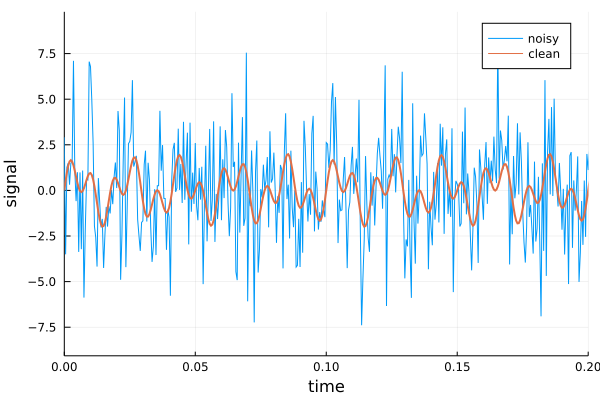

In [337]:
plot(time, f_noisy, label = "noisy", xlabel = "time", ylabel = "signal", x_lims = (0, 0.2))
plot!(time, f_clean, linewidth = 2, label = "clean")

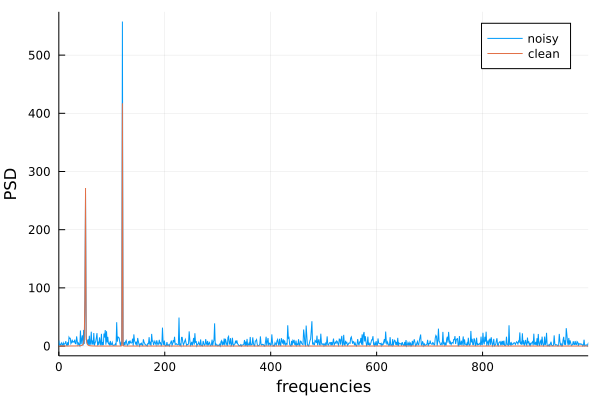

In [338]:
plot(freq, abs.(PSD_noisy), x_lims = (0, freq[end]/2), label = "noisy", xlabel = "frequencies", ylabel = "PSD")
plot!(freq, abs.(PSD_clean), label = "clean")

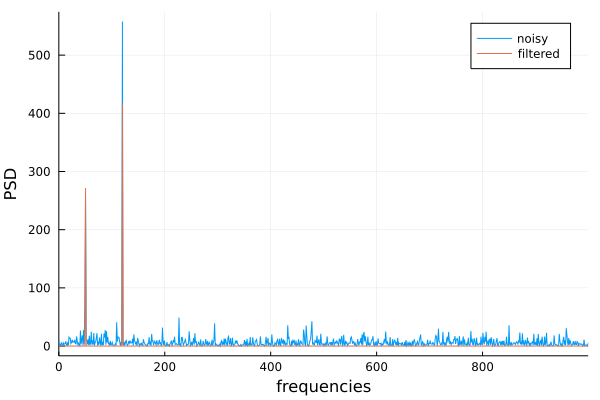

In [339]:
plot(freq, PSD_noisy, x_lims = (0, freq[end]/2), label = "noisy", xlabel = "frequencies", ylabel = "PSD")
plot!(freq, PSD_filtered, label = "filtered")

In [340]:
filtered = ifft(fft_filtered);

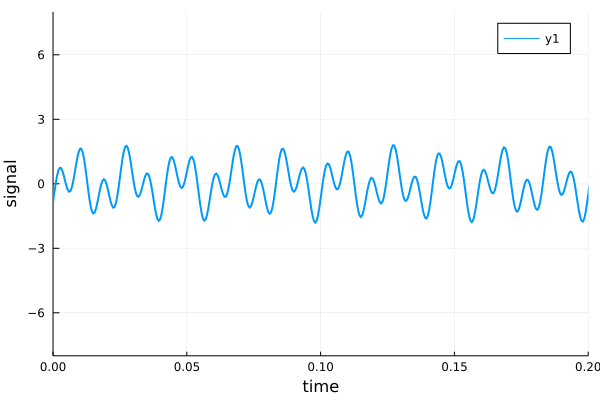

In [341]:
plot(time, real.(filtered), xlabel = "time", ylabel = "signal", x_lims = (0, 0.2), y_lims = (-8, 8), linewidth = 2)

In [342]:
wavwrite(real.(filtered), "filtered_50_120Hz")

In [343]:
wavplay("filtered_50_120Hz")

### Ptaszek

In [344]:
bird1, fs_bird = wavread("petrel_śnieżny.wav")

([-0.0038758507034516434 -0.0034485915707876827; -0.005401776177251503 -0.003662221137119663; … ; -0.0013733329264198737 -0.002410962248603778; -0.001586962492751854 -0.0025025177770317698], 48000.0f0, 0x0010, WAVChunk[WAVChunk(Symbol("fmt "), UInt8[0x10, 0x00, 0x00, 0x00, 0x01, 0x00, 0x02, 0x00, 0x80, 0xbb, 0x00, 0x00, 0x00, 0xee, 0x02, 0x00, 0x04, 0x00, 0x10, 0x00]), WAVChunk(:LIST, UInt8[0x49, 0x4e, 0x46, 0x4f, 0x49, 0x41, 0x52, 0x54, 0x13, 0x00  …  0x35, 0x38, 0x2e, 0x34, 0x35, 0x2e, 0x31, 0x30, 0x30, 0x00])])

In [345]:
bird = bird1[:, 1];

In [346]:
#wavplay("petrel_śnieżny.wav")

In [347]:
N_bird = length(bird)

415397

In [348]:
fft_bird = fft(bird);
PSD_bird = real.(fft_bird .* conj(fft_bird)/N_bird);

In [474]:
time_bird, PSD_filtered_bird, fft_filtered_bird, freq_bird = denoising_low(bird, fs_bird, N_bird, 0.02);

In [475]:
plot(freq_bird, PSD_bird, x_lims = (0, freq_bird[end]/2))

In [476]:
plot(freq_bird, PSD_filtered_bird, x_lims = (0, freq_bird[end]/2))

In [478]:
filtered_bird = ifft(fft_filtered_bird);

In [479]:
plot(time_bird, real.(filtered_bird))
plot!(time_bird, real.(bird))

In [419]:
@time wavplay("petrel_śnieżny.wav")

  9.400579 seconds (1.84 M allocations: 51.080 MiB)


In [480]:
@time wavplay(real.(filtered_bird), fs_bird)

  9.153870 seconds (415.45 k allocations: 13.096 MiB)
